## Analyse of run1 and run3 merged
### organogensis data mapping
### NC data mapping

Zhiyuan Hu \
23 May 2024 

In [54]:
#last modified:
import datetime
datetime.datetime.now().strftime("%B %d, %Y") + ", "+datetime.datetime.now().strftime("%I:%M %p")

'June 01, 2024, 10:35 AM'

In [3]:
import os, sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scanpy as sc
import torch
sys.path.append('./')  # uncomment for local import
import tangram as tg

%load_ext autoreload
%autoreload 2
%matplotlib inline

tg.__version__

/home/huzhiy/miniforge3/envs/tangram-env2/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


'1.0.4'

## read spatial data

In [3]:
ad_sp = sc.read_h5ad('merscope/merscope_run3/results/run1_3/ad_run1_run3_allCells_reclustered.h5ad')
ad_sp

AnnData object with n_obs × n_vars = 26063 × 299
    obs: 'fov', 'volume', 'min_x', 'min_y', 'max_x', 'max_y', 'anisotropy', 'transcript_count', 'perimeter_area_ratio', 'solidity', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'n_counts', 'leiden', 'Cell_Type', 'Cluster', 'sample'
    var: 'mean', 'std'
    uns: 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'sample_colors', 'umap'
    obsm: 'X_pca', 'X_umap', 'blank_genes', 'spatial'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

# Map to Single cell data - wagner et al

In [4]:
ad_sc = sc.read_h5ad("multiome/analysis/ref_mapping/data/Wagner/public_data/WagnerScience2018.processed.h5ad")
ad_sc

AnnData object with n_obs × n_vars = 63530 × 30677
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'n_counts', 'unique_cell_id', 'cell_names', 'library_id', 'batch', 'ClusterID', 'ClusterName', 'TissueID', 'TissueName', 'TimeID', 'ClusterName_short'
    var: '_index', 'features'

For this sample we have 21ss (19.5h) mutant and 4ss (11-12h) wildtype


In [5]:
ad_sc.obs.TimeID.value_counts()

24hpf    34750
18hpf     6962
6hpf      5692
10hpf     4280
4hpf      4277
14hpf     4001
8hpf      3568
Name: TimeID, dtype: int64

In [6]:
ad_sc.var_names = ad_sc.var['_index']
ad_sc.var_names

Index(['LOC100000009', 'LOC100000024', 'LOC100000058', 'LOC100000086',
       'LOC100000094', 'LOC100000098', 'LOC100000110', 'LOC100000119',
       'LOC100000140', 'LOC100000155',
       ...
       'zte38', 'zufsp', 'zw10', 'zwi', 'zwilch', 'zyg11', 'zymnd12', 'zyx',
       'zzef1', 'zzz3'],
      dtype='object', name='_index', length=30677)

In [7]:
ad_sc = ad_sc[ad_sc.obs['TimeID'].isin(['10hpf', '14hpf', '18hpf', '24hpf'])].copy()

In [8]:
ad_sc.obs.ClusterName_short.value_counts()

neural - midbrain              5615
neural - ventral hindbrain     3795
optic cup                      3481
differentiating neurons        3262
neural - dorsal hindbrain      3098
                               ... 
macrophage - ly75                14
mesoderm - pronephric duct       14
pronephric duct - posterior      11
epiphysis                         3
EVL                               2
Name: ClusterName_short, Length: 107, dtype: int64

In [9]:
sc.pp.normalize_total(ad_sc)

## Prepare to map

In [10]:
sc.pp.filter_genes(ad_sc, min_cells=1)
sc.pp.filter_genes(ad_sp, min_cells=1)

ad_sc.var.index = [g.lower() for g in ad_sc.var.index]
ad_sp.var.index = [g.lower() for g in ad_sp.var.index]

In [11]:
markers = ad_sp.var_names
markers = list(markers)
len(markers)

299

In [12]:
tg.pp_adatas(ad_sc, ad_sp, genes=markers)

272 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
272 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [13]:
ad_sc

AnnData object with n_obs × n_vars = 49993 × 30354
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'n_counts', 'unique_cell_id', 'cell_names', 'library_id', 'batch', 'ClusterID', 'ClusterName', 'TissueID', 'TissueName', 'TimeID', 'ClusterName_short'
    var: '_index', 'features', 'n_cells'
    uns: 'training_genes', 'overlap_genes'

In [14]:
ad_sp

AnnData object with n_obs × n_vars = 26063 × 299
    obs: 'fov', 'volume', 'min_x', 'min_y', 'max_x', 'max_y', 'anisotropy', 'transcript_count', 'perimeter_area_ratio', 'solidity', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'n_counts', 'leiden', 'Cell_Type', 'Cluster', 'sample', 'uniform_density', 'rna_count_based_density'
    var: 'mean', 'std', 'n_cells'
    uns: 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'sample_colors', 'umap', 'training_genes', 'overlap_genes'
    obsm: 'X_pca', 'X_umap', 'blank_genes', 'spatial'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [15]:
assert ad_sc.uns['training_genes'] == ad_sp.uns['training_genes']

## Prepare for mapping - check gene consistency
(below is copied from https://github.com/broadinstitute/Tangram/blob/master/tutorial_tangram_without_squidpy.ipynb)
* We can now train the model (ie map the single cell data onto space).
* Mapping should be interrupted after the score plateaus,which can be controlled by passing the num_epochs parameter.
* The score measures the similarity between the gene expression of the mapped cells vs spatial data: higher score means better mapping.
* Note that we obtained excellent mapping even if Tangram converges to a low scores (the typical case is when the spatial data are very sparse): we use the score merely to assess convergence.
* If you are running Tangram with a GPU, uncomment device=cuda:0 and comment the line device=cpu. On a MacBook Pro 2018, it takes ~1h to run. On a P100 GPU it should be done in a few minutes.
* For this basic mapping, we do not use regularizers. More sophisticated loss functions can be used using the Tangram library (refer to manuscript or dive into the code). For example, you can pass your density_prior with the hyperparameter lambda_d to regularize the spatial density of cells. Currently uniform, rna_count_based and customized input array are supported for density_prior argument.
* Instead of mapping single cells, we can "average" the cells within a cluster and map the averaged cells instead, which drammatically improves performances. This suggestion was proposed by Sten Linnarsson. To activate this mode, select mode='clusters' and pass the annotation field to cluster_label.


In [18]:
## need to make sure that the anndata var_names are gene names
ad_sc.var_names = ad_sc.var["features"]
ad_sc.var_names

Index(['LOC100000009', 'LOC100000024', 'LOC100000058', 'LOC100000086',
       'LOC100000094', 'LOC100000098', 'LOC100000110', 'LOC100000119',
       'LOC100000140', 'LOC100000155',
       ...
       'zte38', 'zufsp', 'zw10', 'zwi', 'zwilch', 'zyg11', 'zymnd12', 'zyx',
       'zzef1', 'zzz3'],
      dtype='object', name='features', length=30354)

In [19]:
ad_sp.var_names

Index(['dlx2a', 'foxc1a', 'postnb', 'grem2b', 'bhlhe40', 'foxd3', 'tfec',
       'mitfa', 'itga3a', 'cadm1a',
       ...
       'wnt8b', 'diaph3', 'dld', 'tbx6', 'itm2cb', 'pax6b', 'fhl2a', 'gata5',
       'gata1a', 'twist1b'],
      dtype='object', length=299)

In [20]:
adata_var_names = ad_sc.var_names

# Checking if 'markers' list elements are not in 'adata_var_names'
markers_not_in_adata_var_names = [marker for marker in markers if marker not in adata_var_names]

markers_not_in_adata_var_names

['elf1',
 'inka1a',
 'msx3',
 'bud23',
 'msx2b',
 'ccn2a',
 'ccn1',
 'si:dkey-250k10.4',
 'msx1b',
 'si:ch73-335l21.4',
 'wnt4',
 'krt18a.1',
 'arhgef28a',
 'cu467961.1',
 'adgrl1a',
 'mcf2l2',
 'cabz01029822.1',
 'pcdh1b',
 'tns2a',
 'p3h2',
 'plpp3',
 'gpc5a',
 'cxxc5b',
 'atp5fa1',
 'srgap2',
 'rabl6b',
 'sorbs1']

In [21]:
adata_var_names = ad_sp.var_names

# Checking if 'markers' list elements are not in 'adata_var_names'
markers_not_in_adata_var_names = [marker for marker in markers if marker not in adata_var_names]

markers_not_in_adata_var_names

[]

## mapping

In [23]:
adata_sc=ad_sc#[ad_sc.obs['TimeID'].isin(['10hpf', '14hpf'])].copy()
adata_sp=ad_sp#[ad_sp.obs['regions'].isin(['most right', 'between line1 and line2'])].copy()
genes=None
gene_to_lowercase=True
# remove all-zero-valued genes
sc.pp.filter_genes(adata_sc, min_cells=1)
sc.pp.filter_genes(adata_sp, min_cells=1)

if genes is None:
    # Use all genes
    genes = adata_sc.var.index
           
# put all var index to lower case to align
if gene_to_lowercase:
    adata_sc.var.index = [g.lower() for g in adata_sc.var.index]
    adata_sp.var.index = [g.lower() for g in adata_sp.var.index]
    genes = list(g.lower() for g in genes)

adata_sc.var_names_make_unique()
adata_sp.var_names_make_unique()


# Refine `marker_genes` so that they are shared by both adatas
genes = list(set(genes) & set(adata_sc.var.index) & set(adata_sp.var.index))
# logging.info(f"{len(genes)} shared marker genes.")

adata_sc.uns["training_genes"] = genes
adata_sp.uns["training_genes"] = genes

In [24]:
ad_map_early = tg.map_cells_to_space(
    adata_sc=adata_sc,
    adata_sp=adata_sp,
    cv_train_genes=genes,
    device='cpu',
    mode='clusters',
    cluster_label='ClusterName_short',
    density_prior='uniform' # density_prior specifies the cell density within each spatial voxel. Use uniform if the spatial voxels are at single cell resolution (ie MERFISH). 
)

Allocate tensors for mapping.
Begin training with 272 genes and uniform density_prior in clusters mode...
Printing scores every 100 epochs.
Score: -0.002, KL reg: 0.034
Score: 0.295, KL reg: 0.002
Score: 0.298, KL reg: 0.002
Score: 0.298, KL reg: 0.002
Score: 0.298, KL reg: 0.002
Score: 0.299, KL reg: 0.002
Score: 0.299, KL reg: 0.002
Score: 0.299, KL reg: 0.002
Score: 0.299, KL reg: 0.002
Score: 0.299, KL reg: 0.002
Saving results..


## Downstream analysis

In [25]:
tg.project_cell_annotations(ad_map_early, adata_sp, annotation='ClusterName_short')
annotation_list = list(pd.unique(adata_sc.obs['ClusterName_short']))
annotation_list[1:10]

spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


['endoderm',
 'neural - anterior',
 'epidermal - gbx2',
 'epidermal',
 'neural - hindbrain',
 'tailbud - spinal cord',
 'anterior neural ridge',
 'neural - midbrain',
 'tailbud - PSM']

In [26]:
adata_sp.obs.columns

Index(['fov', 'volume', 'min_x', 'min_y', 'max_x', 'max_y', 'anisotropy',
       'transcript_count', 'perimeter_area_ratio', 'solidity',
       'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts',
       'log1p_total_counts', 'pct_counts_in_top_50_genes',
       'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes',
       'n_counts', 'leiden', 'Cell_Type', 'Cluster', 'sample',
       'uniform_density', 'rna_count_based_density'],
      dtype='object')

In [27]:
adata_sp.obs = adata_sp.obs.join(adata_sp.obsm["tangram_ct_pred"])
adata_sp.obs

,fov,volume,min_x,min_y,max_x,max_y,anisotropy,transcript_count,perimeter_area_ratio,solidity,...,epidermal - acbd7,epidermal - s100a11,heart - mature,neural - floorplate,heart mature,macrophage - ly75,mesoderm - pronephric duct,pronephric duct - posterior,epiphysis,EVL
1705254700003100421_region_0,17.0,2082.671549,4840.872045,7105.348610,4858.618515,7118.524233,1.429568,46.0,0.289043,7.723224,...,2.033258e-07,1.489580e-08,4.800943e-08,6.398374e-09,3.699654e-08,3.901395e-08,7.480495e-09,6.811075e-09,4.235114e-08,5.983694e-09
1705254700003100442_region_0,17.0,2602.309320,4826.757107,7119.784758,4847.087955,7135.445293,1.531491,164.0,0.267505,7.598509,...,7.610170e-09,2.927763e-08,7.417070e-08,1.191978e-08,3.797805e-08,2.675915e-08,1.335515e-08,4.138411e-08,3.047882e-08,8.209099e-09
1705254700003100443_region_0,17.0,1007.023061,4845.404753,7121.028835,4855.795528,7133.325052,1.150881,48.0,0.490223,6.897013,...,1.947446e-08,1.276432e-08,2.347228e-08,1.220872e-08,1.841945e-08,1.677310e-08,3.016289e-09,1.195798e-08,5.335856e-08,1.200792e-08
1705254700003100450_region_0,17.0,252.472290,4852.261296,7126.948436,4858.369302,7132.124221,1.101693,19.0,0.821894,8.000000,...,1.097147e-08,1.987935e-08,1.135597e-08,8.315697e-09,1.441895e-08,8.147379e-09,1.043283e-08,1.228715e-08,3.041857e-08,6.160850e-09
1705254700003100462_region_0,17.0,1961.584547,4790.531730,7128.891936,4806.522297,7142.779582,1.277381,93.0,0.297543,7.795818,...,9.993702e-09,2.676227e-08,1.964812e-08,8.002874e-09,4.646698e-08,1.835861e-08,2.391461e-08,1.022784e-08,5.882330e-08,1.411370e-08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2437749000019200032_region_5,NaN,1125.700548,6962.214798,4519.954773,6971.490828,4534.428612,1.570901,NaN,0.362223,0.989075,...,7.538968e-09,1.900013e-08,2.128864e-08,5.839826e-09,2.454586e-08,1.417712e-08,1.136008e-08,1.237734e-08,5.777299e-08,9.765024e-09
2437749000019200036_region_5,NaN,776.384732,6866.431651,4523.604562,6876.855200,4535.261436,1.190831,NaN,0.514173,0.834920,...,7.364742e-09,2.444570e-08,1.625977e-08,9.566546e-09,2.226170e-08,1.516943e-08,1.151466e-08,2.091213e-08,4.342681e-08,9.530898e-09
2437749000019200038_region_5,NaN,1578.179123,6806.911830,4526.910575,6823.847476,4541.051435,1.107487,NaN,0.340260,0.909561,...,5.671948e-09,5.937937e-07,2.822727e-08,2.568156e-08,2.683776e-08,1.673937e-08,8.066997e-09,2.994980e-07,3.839734e-08,3.958135e-09
2437749000019200039_region_5,NaN,193.777150,6874.502863,4528.883819,6879.565033,4533.898283,1.036798,NaN,0.861544,0.995302,...,2.586480e-08,3.929274e-08,3.497750e-08,1.441279e-08,6.009617e-08,1.388355e-08,9.719480e-09,3.502560e-08,3.204084e-08,1.268447e-09


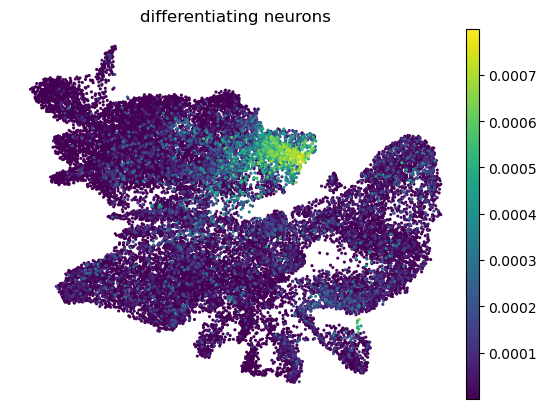

In [28]:
sc.pl.umap(adata_sp, color='differentiating neurons', size=20, frameon=False)

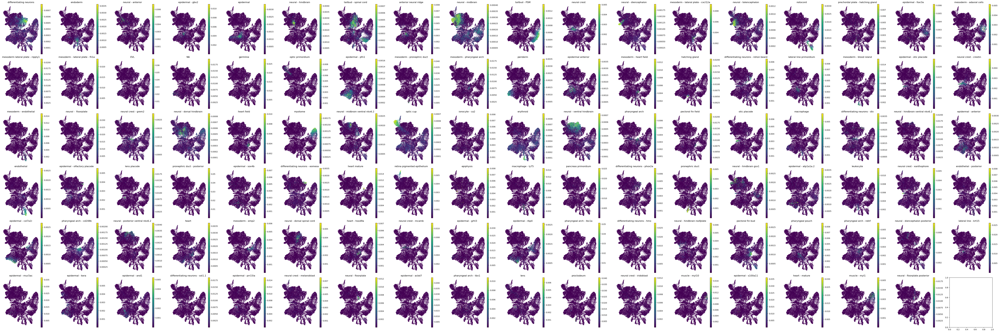

In [35]:
# Define the number of plots based on the length of annotation_list
n_plots = len(annotation_list)
n_cols = int(np.ceil(n_plots / 6))  # Calculate columns needed for 6 rows
fig, axs = plt.subplots(6, n_cols, figsize=(n_cols * 4, 24))  # Adjust the width and height as per number of plots

# Loop through each annotation and plot on the respective axis
for i, annotation in enumerate(annotation_list):
    size = 10 if i == 0 else 10  # First plot has size 20, others have size 10
    row = i // n_cols  # Determine the row of the subplot
    col = i % n_cols   # Determine the column of the subplot
    ax = axs[row, col] if n_cols > 1 else axs[row]  # Adjust indexing based on number of columns
    sc.pl.umap(adata_sp, color=annotation, size=size, frameon=False, show=False, ax=ax)

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()  # Display the plot at the end

In [30]:
import seaborn as sns
import matplotlib.pyplot as plt

# Extract the matrix you want to plot
data_matrix = adata_sp.obsm["tangram_ct_pred"]
data_matrix['Cluster'] = adata_sp.obs['leiden']
# Aggregate data by clusters, calculating the mean for each feature within each cluster
cluster_means = data_matrix.groupby('Cluster').mean()
cluster_means

,neural - midbrain,neural - ventral hindbrain,optic cup,differentiating neurons,neural - dorsal hindbrain,tailbud - spinal cord,erythroid,neural - telencephalon,neural - diencephalon,epidermal - pfn1,...,epidermal - acbd7,epidermal - s100a11,heart - mature,neural - floorplate,heart mature,macrophage - ly75,mesoderm - pronephric duct,pronephric duct - posterior,epiphysis,EVL
Cluster,,,,,,,,,,,,,,,,,,,,,
0,0.000118,1.607340e-04,3.913138e-06,0.000015,0.000014,2.278292e-06,0.000004,1.992785e-05,0.000019,2.134161e-08,...,1.046767e-08,1.047323e-05,2.216832e-05,2.677630e-08,1.033882e-05,1.265744e-05,2.518218e-06,6.524317e-06,4.156300e-05,1.204903e-08
1,0.000021,1.052016e-05,3.242166e-05,0.000018,0.000020,2.832363e-05,0.000045,1.564731e-05,0.000026,1.280114e-04,...,2.758192e-05,2.146337e-05,2.325531e-05,5.618931e-06,5.942772e-06,2.062338e-05,2.832092e-05,1.184592e-05,3.837055e-05,1.632104e-08
2,0.000008,2.164343e-04,9.068698e-07,0.000032,0.000091,1.112507e-04,0.000001,3.903332e-06,0.000002,7.866475e-08,...,1.505808e-08,2.915107e-06,1.073310e-05,3.188381e-05,9.965115e-06,3.146990e-06,5.747039e-07,1.648778e-08,3.479631e-05,1.252651e-08
3,0.000012,5.973116e-06,2.623231e-05,0.000035,0.000101,4.186610e-06,0.000081,3.784595e-05,0.000009,6.183841e-06,...,1.568006e-04,3.313968e-06,1.581884e-05,1.734127e-06,4.837053e-05,6.551320e-08,2.674915e-06,1.050092e-05,3.690999e-05,1.186739e-08
4,0.000026,2.073868e-06,4.842456e-05,0.000022,0.000016,6.925969e-06,0.000087,1.386178e-05,0.000012,1.360166e-04,...,1.466623e-04,1.415270e-04,8.788055e-06,3.243381e-08,9.186755e-06,2.092827e-05,3.035829e-06,1.773588e-05,2.978919e-05,6.143383e-04
5,0.000031,2.261197e-05,2.741026e-05,0.000039,0.000023,1.657560e-04,0.000034,6.934338e-06,0.000023,5.580231e-06,...,1.602879e-05,1.033303e-05,1.946465e-05,1.721568e-06,2.271514e-05,1.000268e-05,1.939868e-06,5.812348e-06,1.860643e-05,1.780832e-08
6,0.000051,3.062813e-05,3.618785e-05,0.000018,0.000026,1.606088e-05,0.000084,2.513218e-05,0.000013,2.481632e-06,...,4.538197e-05,2.318157e-05,2.848236e-06,1.695738e-08,1.635300e-05,8.926269e-06,1.352619e-08,8.550477e-06,2.376661e-05,1.915075e-08
7,0.000024,1.441184e-05,3.433240e-04,0.000005,0.000019,2.492635e-06,0.000004,6.096876e-05,0.000027,7.896079e-07,...,1.672066e-05,5.202924e-06,1.937401e-05,1.151202e-08,2.258705e-05,6.060340e-06,1.092351e-08,1.359432e-08,3.646272e-05,1.212508e-08
8,0.000022,4.644016e-05,1.924779e-05,0.000042,0.000043,2.090675e-04,0.000018,1.135927e-05,0.000012,4.880694e-07,...,2.164535e-08,1.989012e-04,8.641130e-06,7.967856e-05,4.183855e-06,7.615684e-06,3.942911e-05,1.631976e-05,5.265876e-05,2.320328e-06


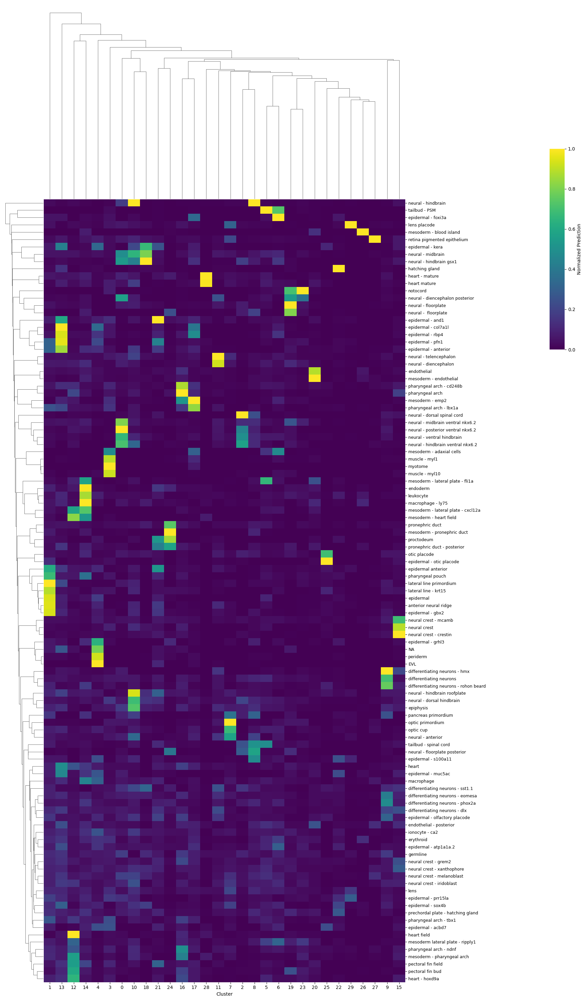

In [36]:
# Normalize each row by its maximum and minimum values
row_scaled = cluster_means.apply(lambda x: (x - x.min()) / (x.max() - x.min()), axis=1)

# Plotting the heatmap of row-scaled data
# Using seaborn's clustermap to cluster rows and columns and plot with dendrograms
g = sns.clustermap(row_scaled.transpose(), method='average', metric='euclidean', cmap='viridis', 
                   figsize=(15, 30), row_cluster=True, col_cluster=True,
                   cbar_kws={'label': 'Normalized Prediction'},
                   dendrogram_ratio=(.1, .2), # Adjust dendrogram size
                   cbar_pos=(1.1, 0.65, 0.03, 0.2))  # Adjust colorbar position

# Adjusting font size for y-tick labels to ensure visibility
plt.setp(g.ax_heatmap.get_yticklabels(), rotation=0, fontsize=9)  # Adjust font size as needed


# Show the plot
plt.show()

## read manual annotation

In [41]:
anno = pd.read_csv("merscope/merscope_run3/results/run1_3/run1_run3_anno_all20240601.csv", sep=',')
anno

,cluster,annotation
0,0,neural-ventral
1,1,lateral line
2,2,neural-dorsalSC/hb
3,3,muscle
4,4,periderm/EVL
5,5,tailbud-PSM
6,6,epidermal-foxi3a
7,7,optic
8,8,neural-hb/mb
9,9,diff.neurons


In [44]:
# Convert 'leiden' to string if it's not already, to ensure matching types with AnnData
anno['cluster'] = anno['cluster'].astype(str)
# Create a dictionary mapping 'leiden' to 'cell_type'
leiden_to_celltype = dict(zip(anno['cluster'], anno['annotation']))
# Ensure the 'leiden' in AnnData is a string, if it's numeric or otherwise
ad_sp.obs['leiden'] = ad_sp.obs['leiden'].astype(str)

# Map cell_type using the dictionary
ad_sp.obs['cell_type'] = ad_sp.obs['leiden'].map(leiden_to_celltype)

## plot spatial

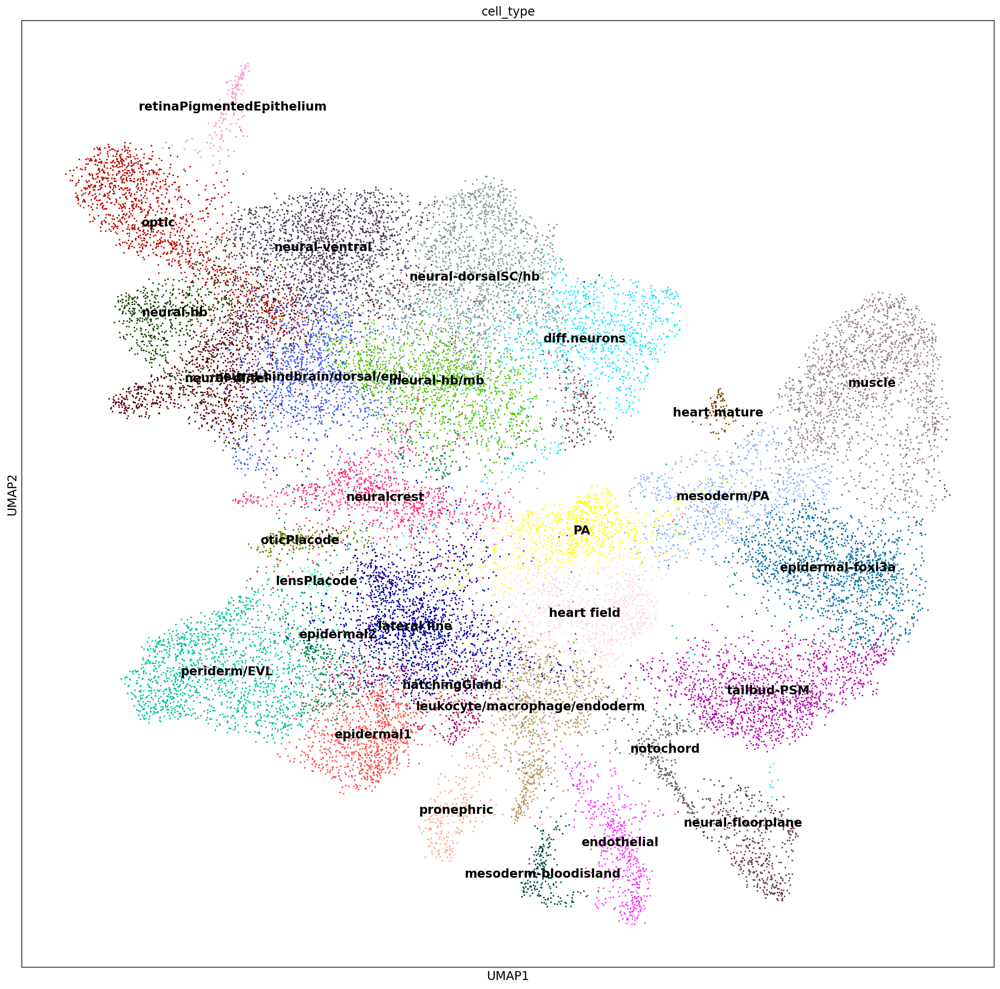

In [45]:
sc.set_figure_params(figsize=(20, 20))
sc.pl.umap(ad_sp, color=["cell_type"], size=15, legend_loc="on data")

In [49]:
ad_sp.write_h5ad("merscope/merscope_run3/results/run1_3/tangram_out_ALLcells_vswanger_20240601.h5ad")

In [50]:
ad_sp.obs['sample'].value_counts()

wt_late     15718
wt_early     5561
mut_late     4784
Name: sample, dtype: int64

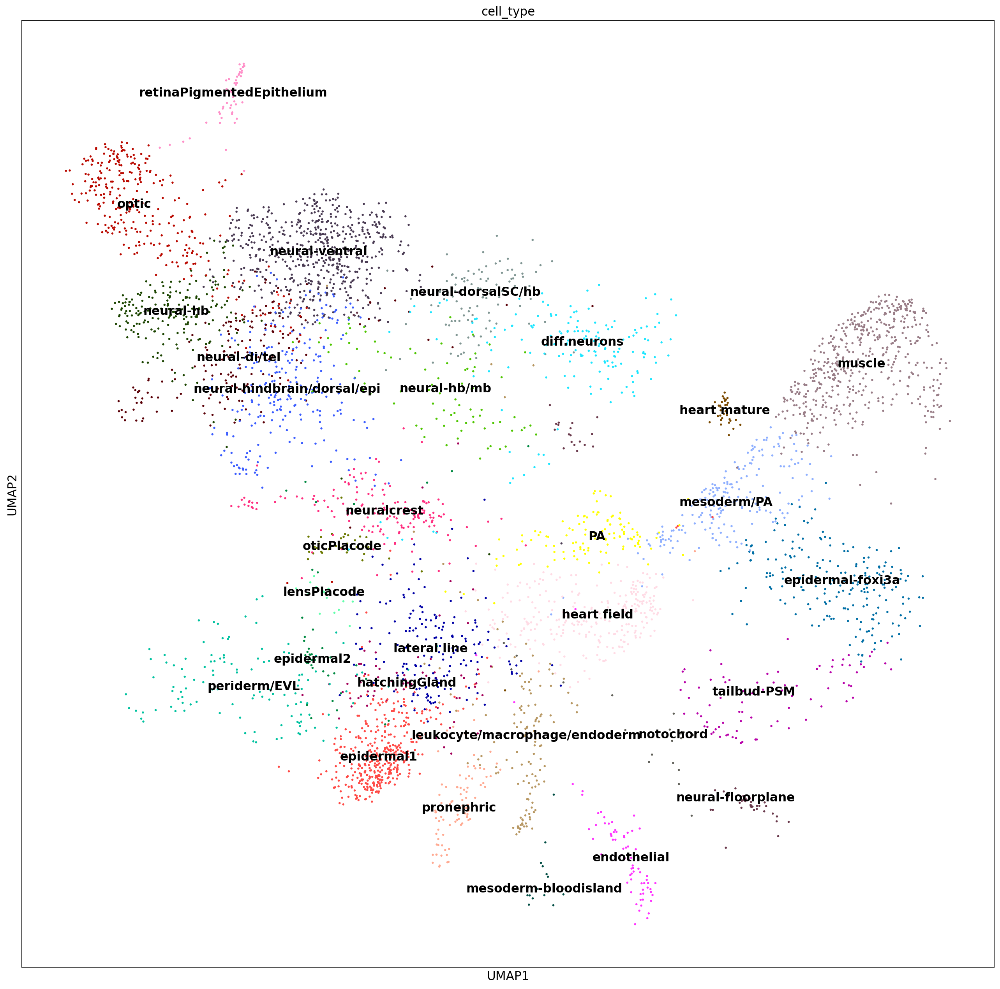

In [52]:
sc.pl.umap(ad_sp[ad_sp.obs['sample'] == 'mut_late'], color=["cell_type"], legend_loc="on data")

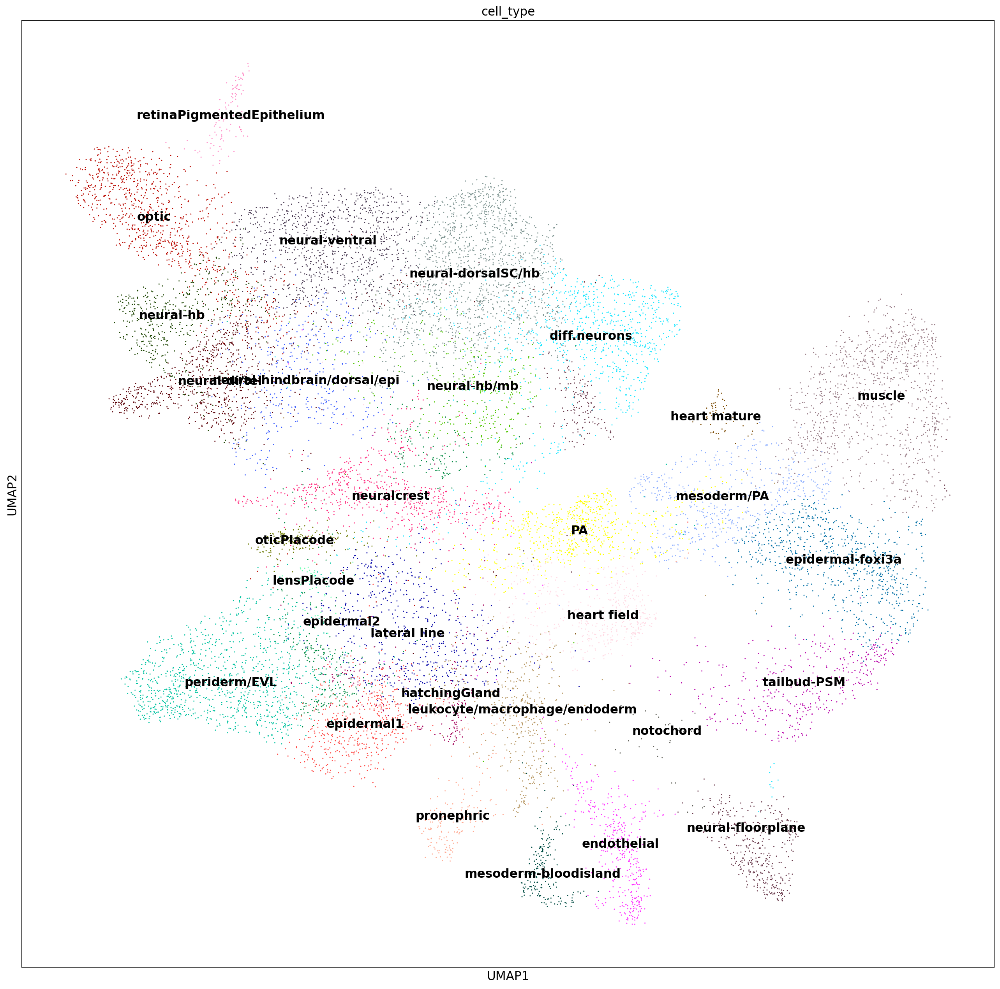

In [54]:
sc.pl.umap(ad_sp[ad_sp.obs['sample'] == 'wt_late'], color=["cell_type"], legend_loc="on data")

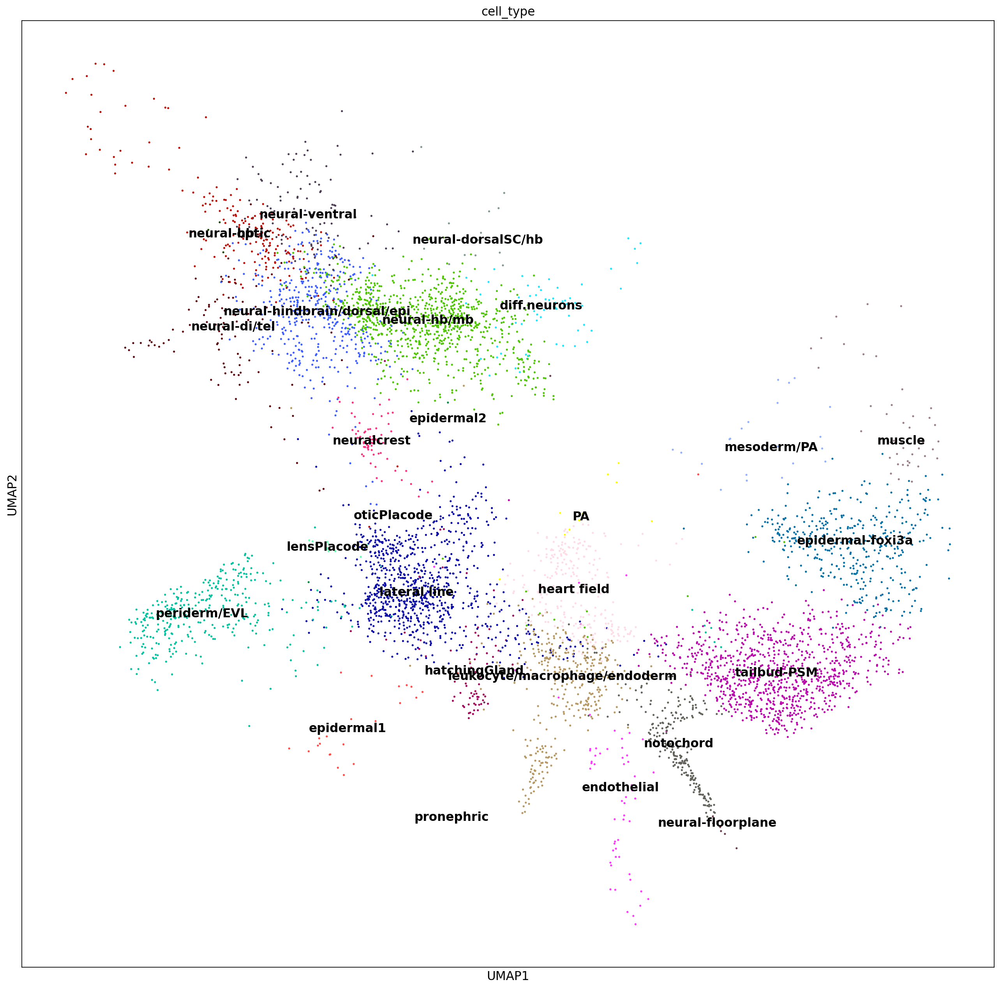

In [55]:
sc.pl.umap(ad_sp[ad_sp.obs['sample'] == 'wt_early'], color=["cell_type"], legend_loc="on data")

# Map to multiome NC data

### reclustering spatial NC subset

In [56]:
ad_nc = ad_all[ (ad_all.obs['leiden'].isin(['15']) ) ].copy()
ad_nc

AnnData object with n_obs × n_vars = 911 × 299
    obs: 'fov', 'volume', 'min_x', 'min_y', 'max_x', 'max_y', 'anisotropy', 'transcript_count', 'perimeter_area_ratio', 'solidity', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'n_counts', 'leiden', 'Cell_Type', 'Cluster', 'sample', 'uniform_density', 'rna_count_based_density', 'neural - midbrain', 'neural - ventral hindbrain', 'optic cup', 'differentiating neurons', 'neural - dorsal hindbrain', 'tailbud - spinal cord', 'erythroid', 'neural - telencephalon', 'neural - diencephalon ', 'epidermal - pfn1', 'pharyngeal arch - cd248b', 'tailbud - PSM', 'neural - hindbrain gsx1', 'neural crest - grem2', 'neural - midbrain ventral nkx6.2', 'endothelial', 'neural - hindbrain', 'endoderm', 'epidermal', 'epidermal - anterior', 'neural - posterior ventral nkx6.2', 'differentiating neurons - dlx', 'differentiating neuron

In [58]:
ad_nc.obs["leiden_broad"] = ad_nc.obs["leiden"]
ad_nc.obsm["X_umap_broad"] = ad_nc.obsm["X_umap"]

In [59]:
del ad_nc.obsm["X_umap"]

In [70]:
resolution = 1
sc.tl.pca(ad_nc, svd_solver='arpack')
sc.pp.neighbors(ad_nc, n_neighbors=5, n_pcs=12 )
sc.tl.tsne(ad_nc, perplexity = 20, learning_rate = 200)
sc.tl.leiden(ad_nc, resolution=resolution)

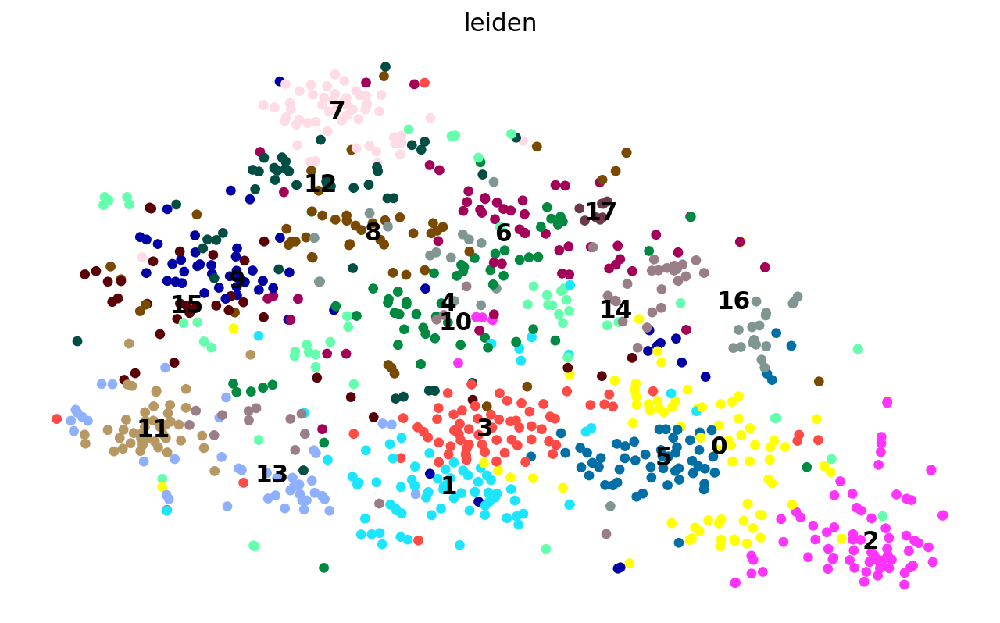

In [71]:
sc.set_figure_params(figsize=(10, 6))
sc.pl.tsne(ad_nc, color= "leiden", frameon=False, legend_loc="on data")

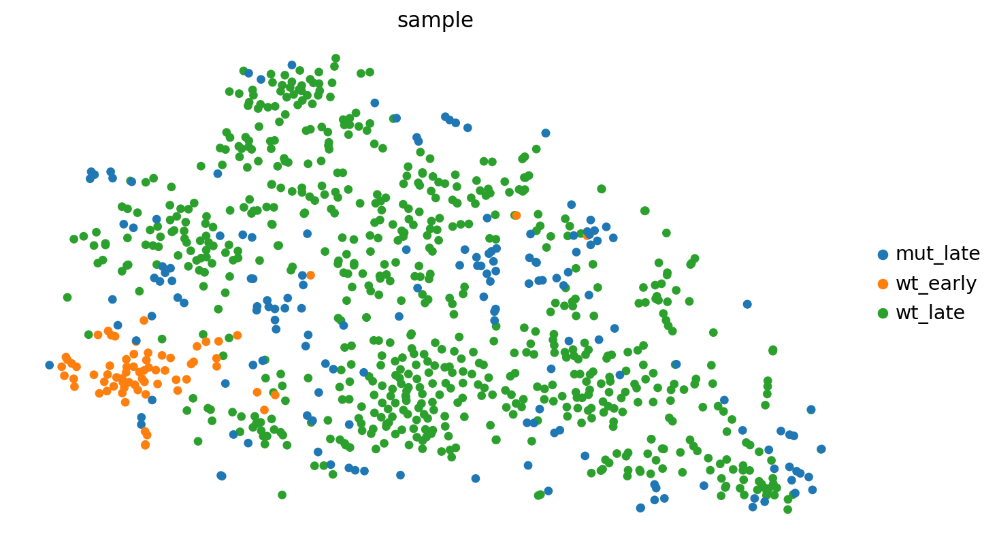

In [73]:
sc.pl.tsne(ad_nc, color= "sample", frameon=False)

### Single cell data

In [74]:
path = os.path.join('multiome/analysis_newref/velocity',"data/seurat/seu_RNAsoupx_NC.h5ad")
ad_sc = sc.read_h5ad(path)
ad_sc.var.index = ad_sc.var["_index"]
ad_sc

AnnData object with n_obs × n_vars = 16550 × 27599
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'sample_id', 'sample', 'stage', 'genotype', 'DoubletFinder', 'TSSEnrichment', 'ReadsInTSS', 'ReadsInPromoter', 'ReadsInBlacklist', 'PromoterRatio', 'PassQC', 'NucleosomeRatio', 'nMultiFrags', 'nMonoFrags', 'nFrags', 'nDiFrags', 'DoubletScore', 'DoubletEnrichment', 'BlacklistRatio', 'demuxlet_singlet', 'RNA_snn_res.0.6', 'seurat_clusters', 'major_clusters', 'NTorNC', 'RNA_snn_res.0.8', 'major_clusters_NTnNC', 'RNA_snn_res.1', 'genotype_new', 'S.Score', 'G2M.Score', 'Phase', 'cell_type'
    var: '_index', 'features'
    uns: 'neighbors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'distances'

In [75]:
# Second condition: late mutant
condition1 = (ad_sc.obs['genotype_new'] == 'cit') 

# Second condition: late mutant
condition2 = (ad_sc.obs['genotype_new'] == 'dp') & (ad_sc.obs['stage'].isin([3]))

# Combine both conditions using logical OR operator |
combined_condition = condition1 | condition2

# Filter the Anndata object based on the combined condition
ad_sc = ad_sc[combined_condition].copy()

In [76]:
ad_sc.obs['cell_type'].value_counts()

dNC_nohox               1313
mNC_nohox               1171
mNC_arch1               1140
Pigment_sox6_high       1045
Mutant_nohox_cycling     977
mNC_head_mesenchymal     958
mNC_arch2                912
mNC_hox34                766
dNC_hoxa2b               605
dNC_nohox_cycling        565
Pigment_gch2_high        547
Mutant_hox2              501
Mutant_pigment           492
NPB_nohox                404
dNC_hox34                372
mNC_vagal                354
NC_trunk                 354
Mutant_nohox_12_22ss     348
NPB_hox3                 315
Mutant_hox3              241
NPB_nohox_cycling        146
NPB_hox2                 129
Mutant_nohox_early        67
Name: cell_type, dtype: int64

In [77]:
# Replace all occurrences of 'dNC_nohox_cycling' with 'dNC_nohox' in the 'cell_type' column
ad_sc.obs['cell_type'] = ad_sc.obs['cell_type'].replace('dNC_nohox_cycling', 'dNC_nohox')
ad_sc.obs['cell_type'] = ad_sc.obs['cell_type'].replace('NPB_nohox_cycling', 'NPB_nohox')
#ad_sc = ad_sc[ ~ad_sc.obs['cell_type'].isin(["Mutant_hox2","Mutant_nohox_early"])].copy()

In [78]:
np.unique(ad_sc.X.toarray()[0, :])

array([0.00000000e+00, 2.00060634e-02, 9.30038549e-02, ...,
       8.47008704e+01, 1.18548189e+02, 2.28533380e+02])

In [79]:
sc.pp.normalize_total(ad_sc)

### Prepare to map

In [81]:
sc.pp.filter_genes(ad_sc, min_cells=1)
sc.pp.filter_genes(ad_nc, min_cells=1)

ad_sc.var.index = [g.lower() for g in ad_sc.var.index]
ad_nc.var.index = [g.lower() for g in ad_nc.var.index]

In [82]:
markers = ad_nc.var_names
markers = list(markers)
len(markers)

299

In [83]:
tg.pp_adatas(ad_sc, ad_nc, genes=markers)

299 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
299 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [85]:
ad_nc.var.index 

Index(['dlx2a', 'foxc1a', 'postnb', 'grem2b', 'bhlhe40', 'foxd3', 'tfec',
       'mitfa', 'itga3a', 'cadm1a',
       ...
       'wnt8b', 'diaph3', 'dld', 'tbx6', 'itm2cb', 'pax6b', 'fhl2a', 'gata5',
       'gata1a', 'twist1b'],
      dtype='object', length=299)

### Map
(below is copied from https://github.com/broadinstitute/Tangram/blob/master/tutorial_tangram_without_squidpy.ipynb)

In [86]:
adata_sc=ad_sc
adata_sp=ad_nc
genes=None
gene_to_lowercase=True
# remove all-zero-valued genes
sc.pp.filter_genes(adata_sc, min_cells=1)
sc.pp.filter_genes(adata_sp, min_cells=1)

if genes is None:
    # Use all genes
    genes = adata_sc.var.index
           
# put all var index to lower case to align
if gene_to_lowercase:
    adata_sc.var.index = [g.lower() for g in adata_sc.var.index]
    adata_sp.var.index = [g.lower() for g in adata_sp.var.index]
    genes = list(g.lower() for g in genes)

adata_sc.var_names_make_unique()
adata_sp.var_names_make_unique()


# Refine `marker_genes` so that they are shared by both adatas
genes = list(set(genes) & set(adata_sc.var.index) & set(adata_sp.var.index))
# logging.info(f"{len(genes)} shared marker genes.")

adata_sc.uns["training_genes"] = genes
adata_sp.uns["training_genes"] = genes

In [87]:
ad_map = tg.map_cells_to_space(
    adata_sc=ad_sc,
    adata_sp=ad_nc,
    cv_train_genes=genes,
    device='cpu',
    mode='clusters',
    learning_rate = 0.01,
    cluster_label='cell_type',
    density_prior='uniform' # density_prior specifies the cell density within each spatial voxel. Use uniform if the spatial voxels are at single cell resolution (ie MERFISH). 
)

Allocate tensors for mapping.
Begin training with 299 genes and uniform density_prior in clusters mode...
Printing scores every 100 epochs.
Score: -0.022, KL reg: 0.050
Score: 0.031, KL reg: 0.005
Score: 0.080, KL reg: 0.004
Score: 0.109, KL reg: 0.004
Score: 0.121, KL reg: 0.004
Score: 0.124, KL reg: 0.004
Score: 0.126, KL reg: 0.004
Score: 0.127, KL reg: 0.003
Score: 0.128, KL reg: 0.003
Score: 0.128, KL reg: 0.003
Saving results..


### Downstream analysis

In [89]:
tg.project_cell_annotations(ad_map, ad_nc, annotation='cell_type')
annotation_list = list(pd.unique(adata_sc.obs['cell_type']))
annotation_list[1:10]

spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


['Pigment_gch2_high',
 'mNC_head_mesenchymal',
 'Pigment_sox6_high',
 'mNC_arch1',
 'mNC_hox34',
 'mNC_vagal',
 'mNC_nohox',
 'NC_trunk',
 'Mutant_hox2']

In [90]:
adata_sp.obs.columns

Index(['fov', 'volume', 'min_x', 'min_y', 'max_x', 'max_y', 'anisotropy',
       'transcript_count', 'perimeter_area_ratio', 'solidity',
       ...
       'heart mature', 'macrophage - ly75', 'mesoderm - pronephric duct',
       'pronephric duct - posterior', 'epiphysis', 'EVL', 'cell_type',
       'cell_type_run1', 'cell_type_run1_run3', 'leiden_broad'],
      dtype='object', length=135)

In [92]:
adata_sp.obs = adata_sp.obs.join(adata_sp.obsm["tangram_ct_pred"])

ValueError: columns overlap but no suffix specified: Index(['dNC_nohox', 'mNC_nohox', 'mNC_arch1', 'Pigment_sox6_high',
       'Mutant_nohox_cycling', 'mNC_head_mesenchymal', 'mNC_arch2',
       'mNC_hox34', 'dNC_hoxa2b', 'NPB_nohox', 'Pigment_gch2_high',
       'Mutant_hox2', 'Mutant_pigment', 'dNC_hox34', 'mNC_vagal', 'NC_trunk',
       'Mutant_nohox_12_22ss', 'NPB_hox3', 'Mutant_hox3', 'NPB_hox2',
       'Mutant_nohox_early'],
      dtype='object')

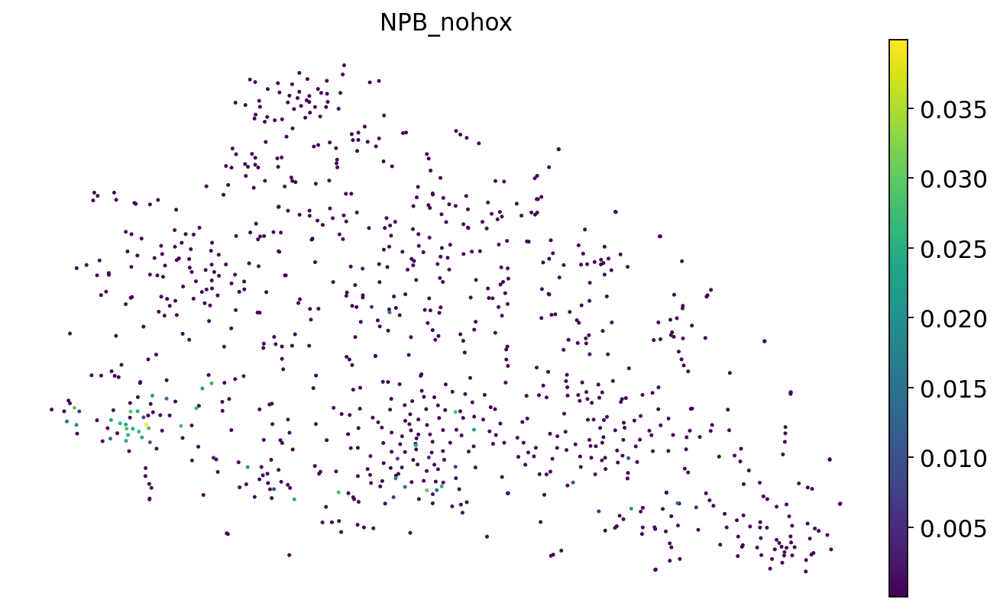

In [95]:
sc.pl.tsne(adata_sp, color='NPB_nohox', size=20, frameon=False)

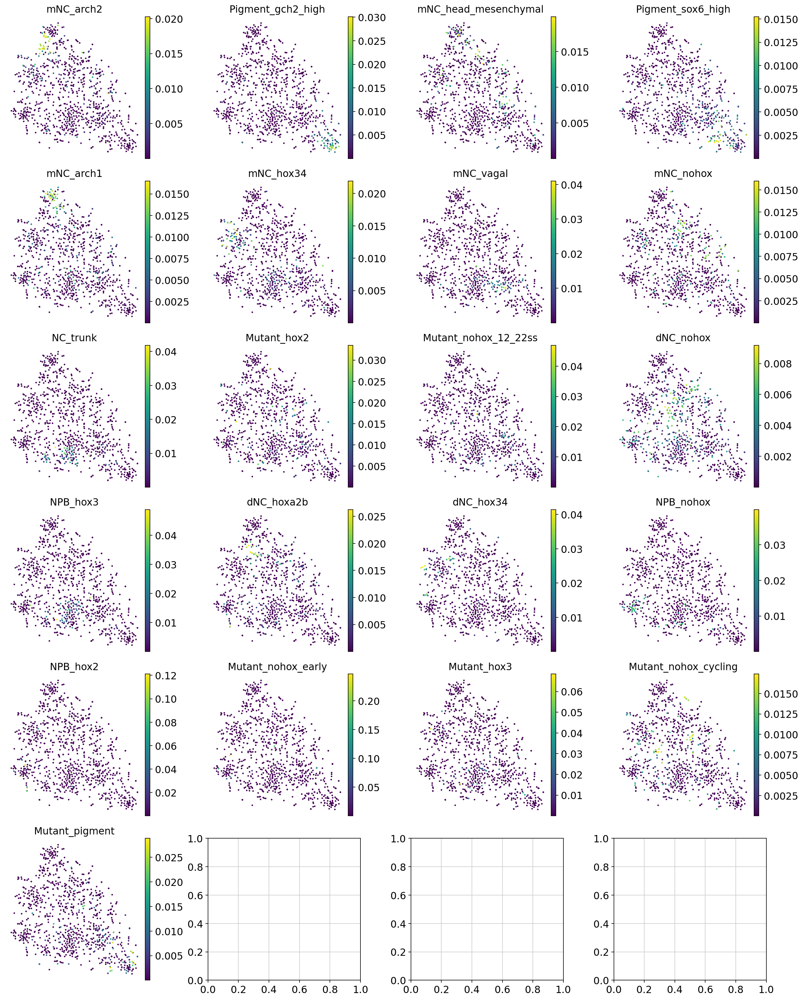

In [98]:
# Define the number of plots based on the length of annotation_list
n_plots = len(annotation_list)
n_cols = int(np.ceil(n_plots / 6))  # Calculate columns needed for 6 rows
fig, axs = plt.subplots(6, n_cols, figsize=(n_cols * 4, 20))  # Adjust the width and height as per number of plots

# Loop through each annotation and plot on the respective axis
for i, annotation in enumerate(annotation_list):
    size = 20 if i == 0 else 20  # First plot has size 20, others have size 10
    row = i // n_cols  # Determine the row of the subplot
    col = i % n_cols   # Determine the column of the subplot
    ax = axs[row, col] if n_cols > 1 else axs[row]  # Adjust indexing based on number of columns
    sc.pl.tsne(adata_sp, color=annotation, size=size, frameon=False, show=False, ax=ax)

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()  # Display the plot at the end

In [100]:
import seaborn as sns
import matplotlib.pyplot as plt

# Extract the matrix you want to plot
data_matrix = adata_sp.obsm["tangram_ct_pred"]
data_matrix['Cluster'] = adata_sp.obs['leiden']
# Aggregate data by clusters, calculating the mean for each feature within each cluster
cluster_means = data_matrix.groupby('Cluster').mean()

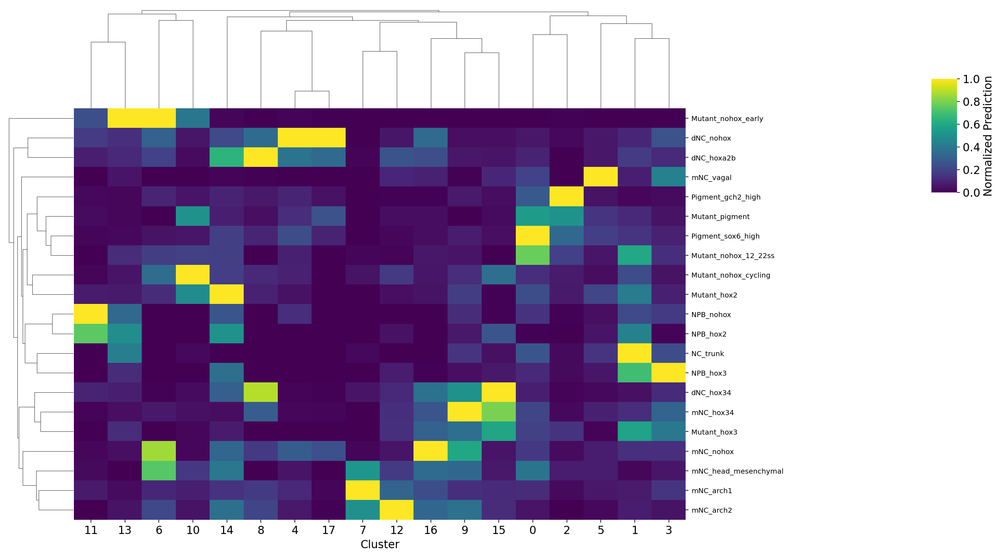

In [102]:
# Normalize each row by its maximum and minimum values
row_scaled = cluster_means.apply(lambda x: (x - x.min()) / (x.max() - x.min()), axis=1)

# Plotting the heatmap of row-scaled data
# Using seaborn's clustermap to cluster rows and columns and plot with dendrograms
g = sns.clustermap(row_scaled.transpose(), method='average', metric='euclidean', cmap='viridis', 
                   figsize=(15, 10), row_cluster=True, col_cluster=True,
                   cbar_kws={'label': 'Normalized Prediction'},
                   dendrogram_ratio=(.1, .2), # Adjust dendrogram size
                   cbar_pos=(1.1, 0.65, 0.03, 0.2))  # Adjust colorbar position

# Adjusting font size for y-tick labels to ensure visibility
plt.setp(g.ax_heatmap.get_yticklabels(), rotation=0, fontsize=9)  # Adjust font size as needed


# Show the plot
plt.show()

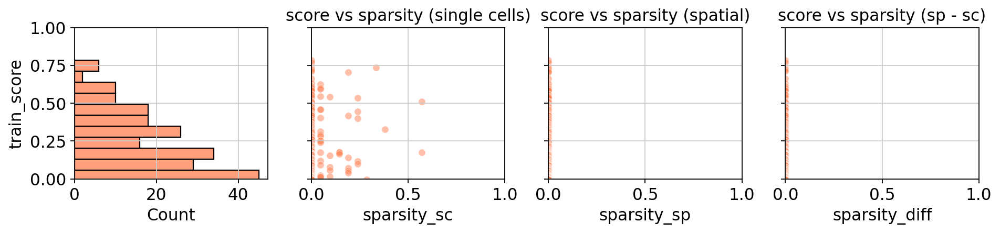

In [105]:
tg.plot_training_scores(ad_map, bins=20, alpha=.5)

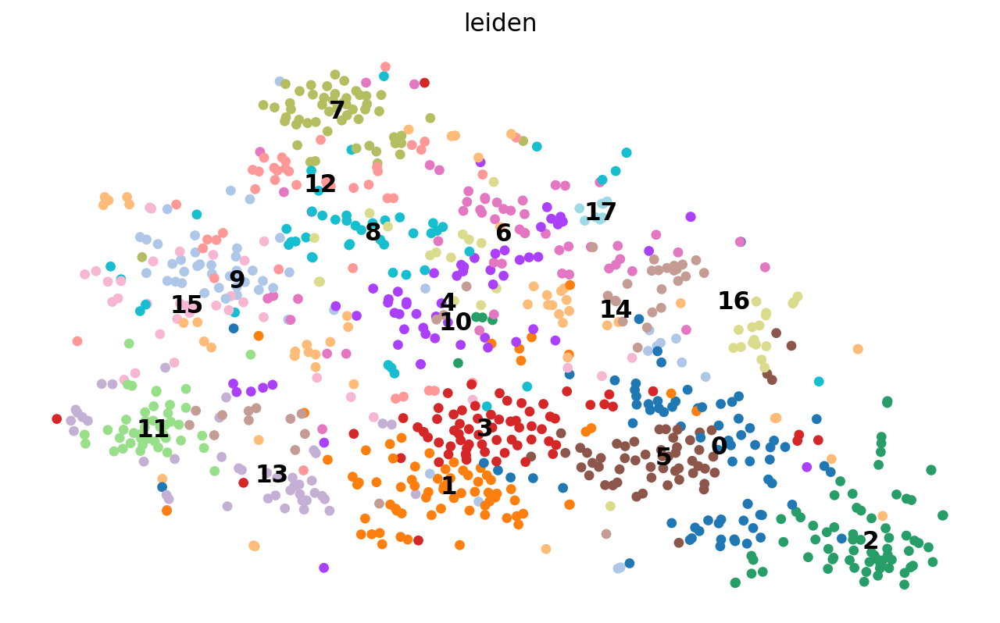

In [106]:
sc.set_figure_params(figsize=(10, 6))
sc.pl.tsne(ad_nc, color= "leiden", frameon=False, legend_loc="on data")

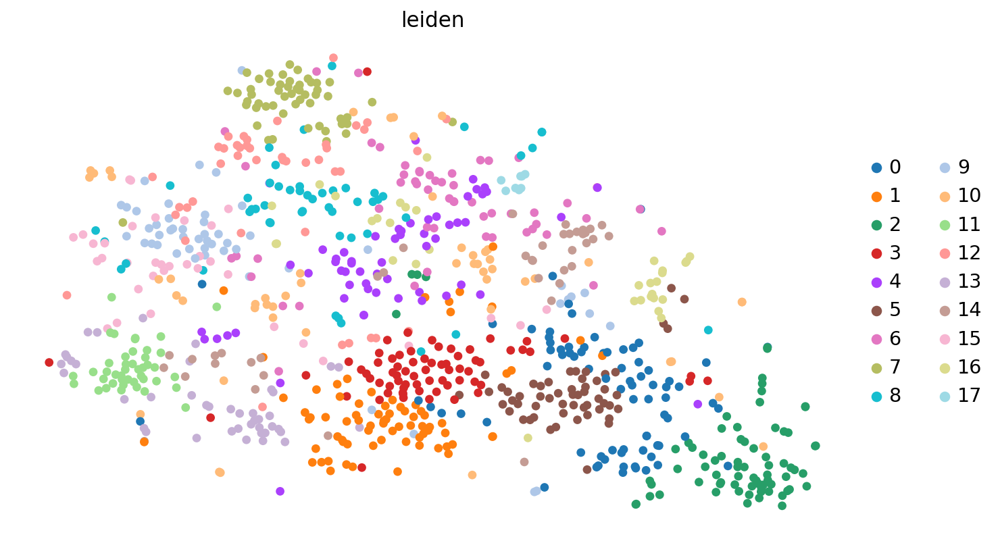

In [108]:
sc.pl.tsne(ad_nc, color= "leiden", frameon=False)

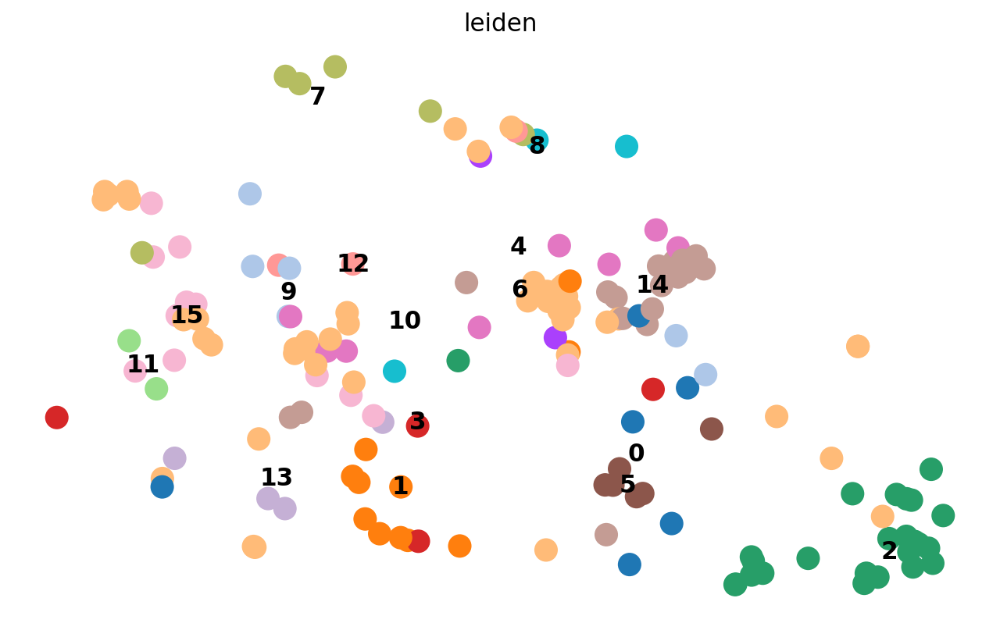

In [110]:
sc.pl.tsne(ad_nc[ad_nc.obs["sample"] == "mut_late"].copy(), color= "leiden", frameon=False, legend_loc="on data")

## read manual annotation

In [146]:
anno = pd.read_csv("merscope/merscope_run3/results/run1_3/run1_run3_anno_NC20240601.csv", sep=',')
anno[0:3]

,cluster,annotation,color
0,0,Mutant_nohox_12_22ss/mNC_vagal/pigment,#DC9DA6
1,1,NC_trunk/NPB/Mutant-hox3,#A6CEE3
2,2,Pigment_gch2_high/Mutant_pigment,#9A77B8


In [147]:
# Convert 'leiden' to string if it's not already, to ensure matching types with AnnData
anno['cluster'] = anno['cluster'].astype(str)
# Create a dictionary mapping 'leiden' to 'cell_type'
leiden_to_celltype = dict(zip(anno['cluster'], anno['annotation']))
# Ensure the 'leiden' in AnnData is a string, if it's numeric or otherwise
ad_nc.obs['leiden'] = ad_nc.obs['leiden'].astype(str)

# Map cell_type using the dictionary
ad_nc.obs['cell_type'] = ad_nc.obs['leiden'].map(leiden_to_celltype)

## plot clusters

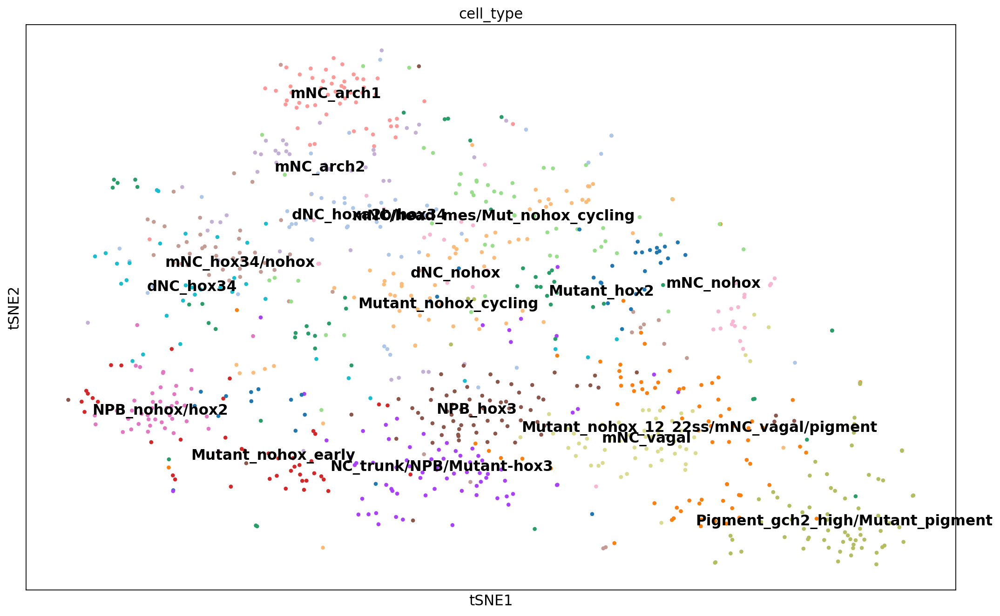

In [148]:
sc.set_figure_params(figsize=(16, 10))
sc.pl.tsne(ad_nc, color=["cell_type"], size=60, legend_loc="on data")

In [149]:
ad_nc.write_h5ad("merscope/merscope_run3/results/run1_3/tangram_out_NCcells_vsmultiomeNC_20240601.h5ad")

In [150]:
ad_nc.obs['sample'].value_counts()

wt_late     678
mut_late    164
wt_early     69
Name: sample, dtype: int64

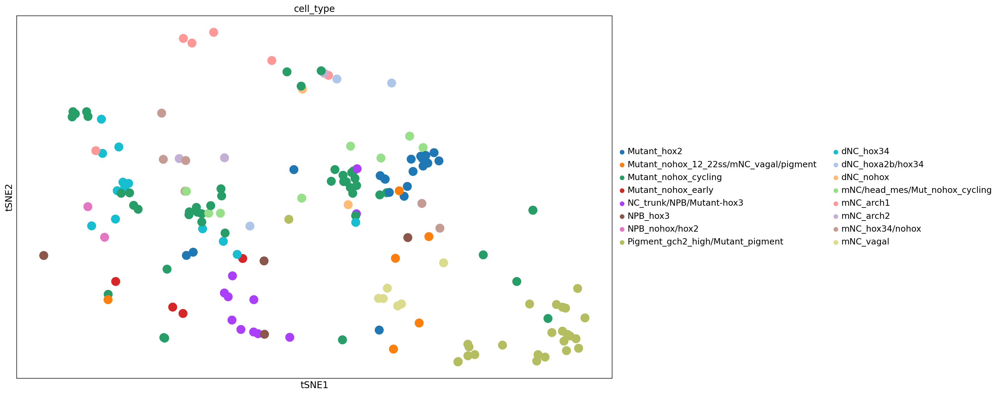

In [151]:
sc.pl.tsne(ad_nc[ad_nc.obs['sample'] == 'mut_late'], color=["cell_type"])

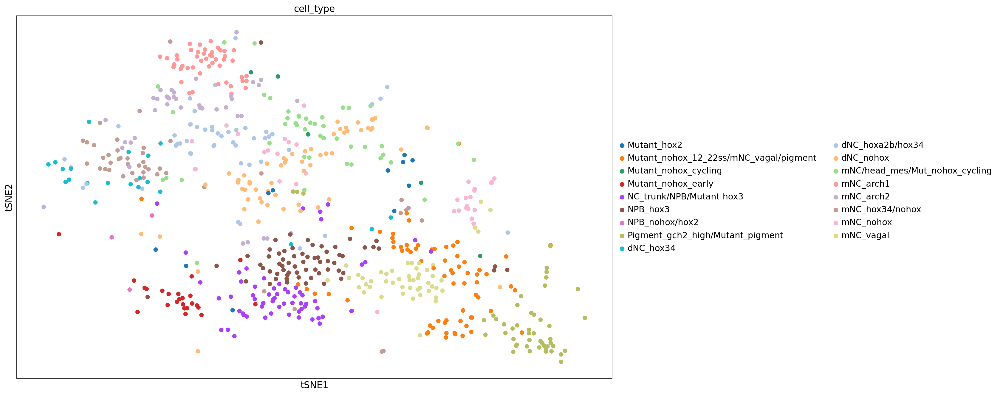

In [152]:
sc.pl.tsne(ad_nc[ad_nc.obs['sample'] == 'wt_late'], color=["cell_type"])

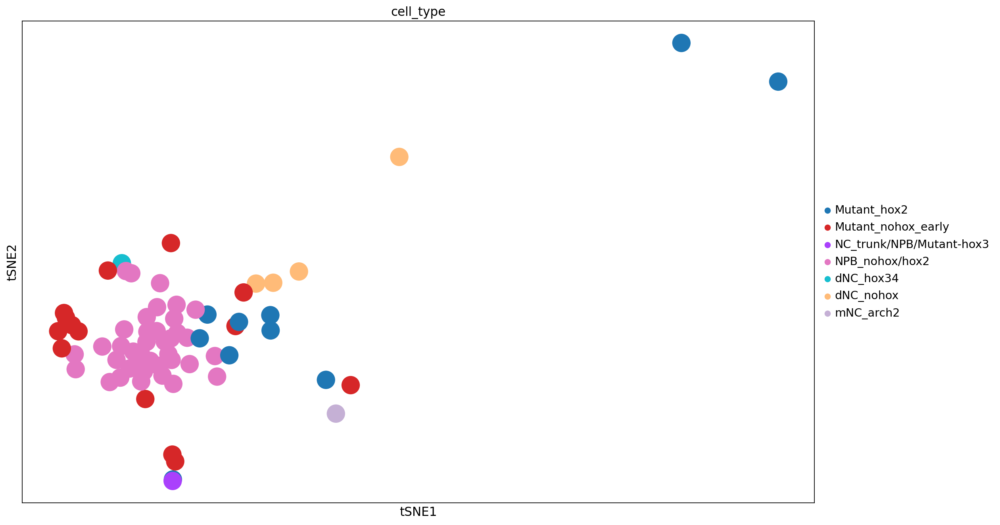

In [153]:
sc.pl.tsne(ad_nc[ad_nc.obs['sample'] == 'wt_early'], color=["cell_type"])

## view run1 cell type in the same coordinates

In [154]:
ad_run1 = sc.read_h5ad("merscope/analysis/clustering_mapping/figures/run1/ad_sp_NC_annotated.h5ad")

In [155]:
ad_run1

AnnData object with n_obs × n_vars = 1545 × 276
    obs: 'fov', 'volume', 'min_x', 'min_y', 'max_x', 'max_y', 'anisotropy', 'transcript_count', 'perimeter_area_ratio', 'solidity', 'Cellbound2_raw', 'Cellbound2_high_pass', 'Cellbound1_raw', 'Cellbound1_high_pass', 'PolyT_raw', 'PolyT_high_pass', 'Cellbound3_raw', 'Cellbound3_high_pass', 'DAPI_raw', 'DAPI_high_pass', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_300_genes', 'n_counts', 'leiden', 'Cell_Type', 'Cluster', 'leiden_broad', 'uniform_density', 'rna_count_based_density', 'dNC_nohox', 'mNC_nohox', 'mNC_arch1', 'Pigment_sox6_high', 'mNC_head_mesenchymal', 'mNC_arch2', 'mNC_hox34', 'dNC_hoxa2b', 'dNC_hox34', 'Pigment_gch2_high', 'mNC_vagal', 'NPB_hox3', 'NPB_nohox', 'NC_trunk', 'NPB_hox2', 'Mutant_nohox_12_22ss', 'cell_type', 'cell_type_new'
    var: 'n_cells_by_counts', 'mean_counts

In [156]:
ad_nc.obs["NC_states2"] = ad_run1.obs.loc[ad_run1.obs_names.isin(ad_nc.obs_names), "cell_type_new"]

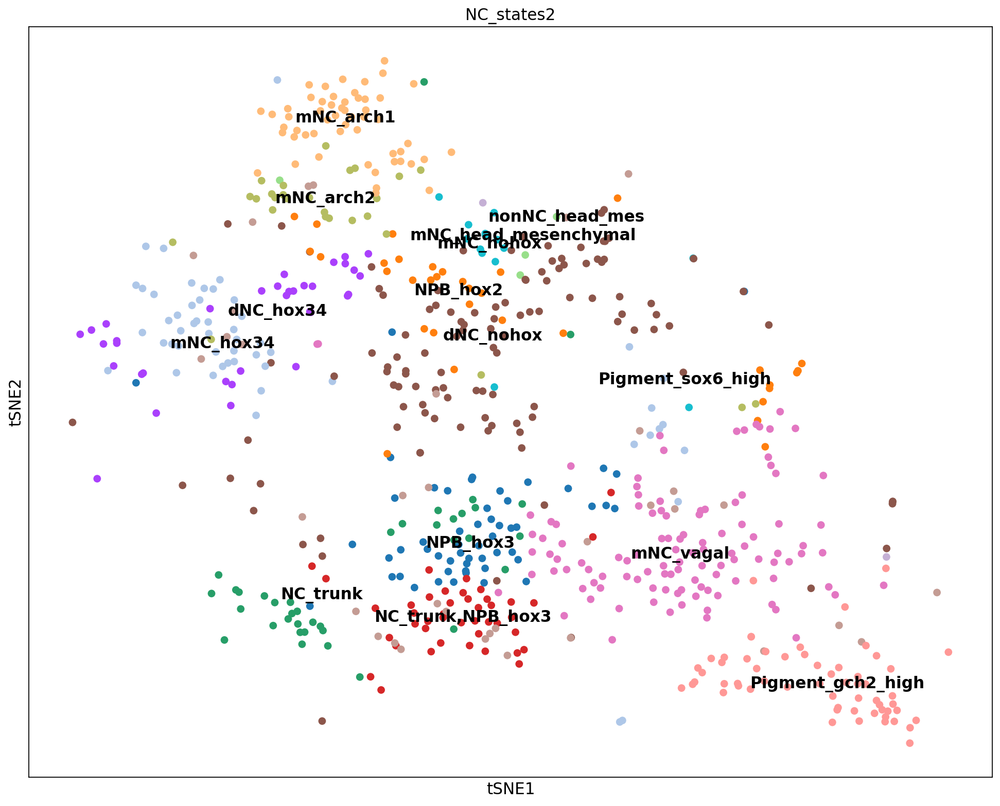

In [157]:
sc.set_figure_params(figsize=(15, 12))
sc.pl.tsne(ad_nc[ad_nc.obs['sample'] == 'wt_late'].copy(), color=["NC_states2"], legend_loc="on data")

In [163]:
import seaborn as sns
from sklearn.metrics import confusion_matrix

# Create a dataframe with the cell types
cell_types = ad_nc.obs[["NC_states2", "cell_type"]]
# Drop rows with NaNs in 'cell_type' or 'cell_type_run1'
cell_types = cell_types.dropna(subset=["cell_type", "NC_states2"])
cell_types


,NC_states2,cell_type
1705254700003100462_region_0,mNC_nohox,mNC/head_mes/Mut_nohox_cycling
1705254700003100515_region_0,dNC_nohox,Mutant_nohox_12_22ss/mNC_vagal/pigment
1705254700003100530_region_0,dNC_nohox,Pigment_gch2_high/Mutant_pigment
1705254700003100543_region_0,dNC_nohox,Pigment_gch2_high/Mutant_pigment
1705254700003100552_region_0,mNC_hox34,dNC_hox34
...,...,...
1705260600008100420_region_9,mNC_vagal,mNC_vagal
1705260600008100466_region_9,NC_trunk,NPB_hox3
1705260600008100473_region_9,NPB_hox3,Mutant_nohox_12_22ss/mNC_vagal/pigment
1705260600008200346_region_9,NPB_hox3,NPB_hox3


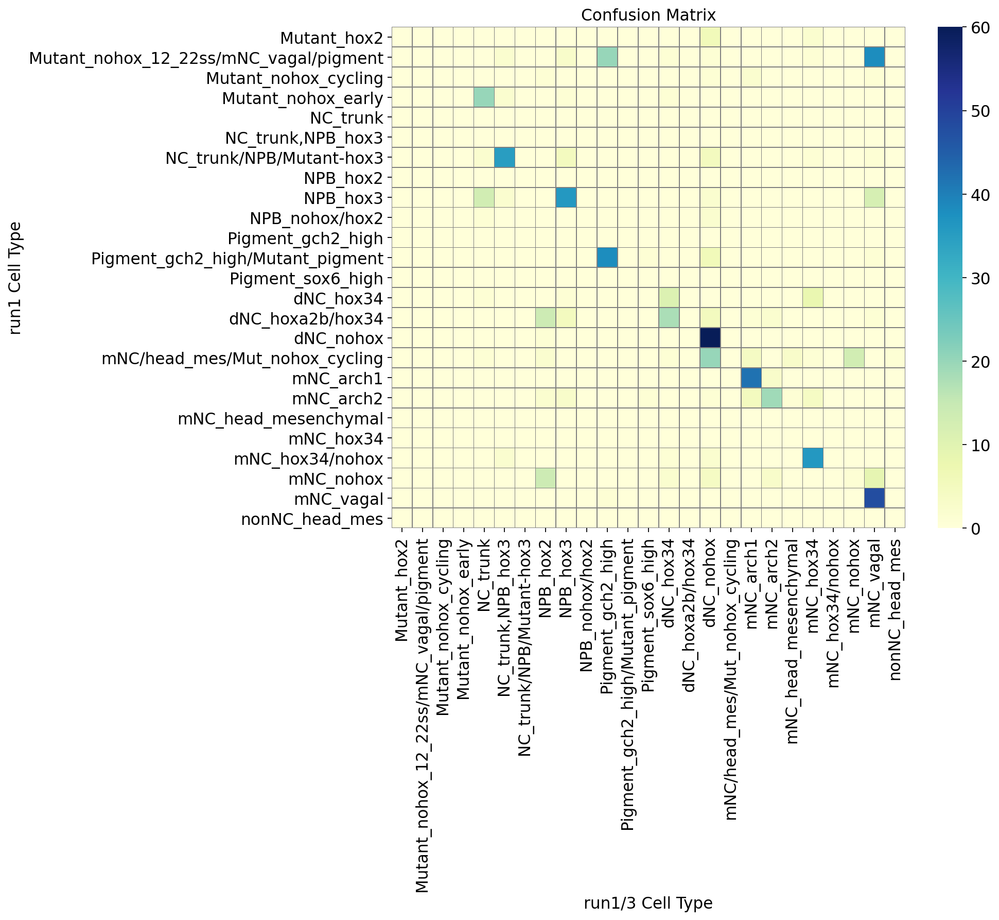

In [165]:
# Get unique labels for both true and predicted cell types
labels = sorted(set(cell_types["cell_type"]).union(set(cell_types["NC_states2"])))

# Create confusion matrix with the consistent labels
confusion_mat = confusion_matrix(cell_types["cell_type"], cell_types["NC_states2"], labels=labels)

# Plot confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(confusion_mat, cmap="YlGnBu", annot=False, fmt=".0f", xticklabels=labels, yticklabels=labels,linecolor='grey', linewidths=0.3)
plt.title("Confusion Matrix")
plt.xlabel("run1/3 Cell Type")
plt.ylabel("run1 Cell Type")
plt.show()